# Relationship between roads and LULC classes

- Load road network and LULC files
- Buffer road network
- Spatial Join by Intersection LULC to road network 
- Calculate pivot tables per road types and LULC classes
- Calculate Pearson and Spearman Correlation matrix between LULC classes
- Hierarchial Clustering of road types

In [75]:
from pathlib import Path

import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats import pearsonr

crs = 25832

sns.set_theme(style='ticks')
sns.set_context('paper')

plt.rcParams['font.size'] = 12  # Adjust base font size as needed
plt.rcParams['axes.labelsize'] = 12  # For x and y labels
plt.rcParams['axes.titlesize'] = 12  # For subplot titles
plt.rcParams['xtick.labelsize'] = 12  # For x-axis tick labels
plt.rcParams['ytick.labelsize'] = 12  # For y-axis tick labels

data_dir = Path('../data')
out_dir = Path('../outdir')

In [2]:
cmap_diverging = 'BrBG'
colors = plt.get_cmap(cmap_diverging)(np.linspace(0.5, 1.0,  plt.get_cmap(cmap_diverging).N // 2))
cmap_sequential = LinearSegmentedColormap.from_list('my_sequential', colors)

In [35]:
road_network = gpd.read_feather(out_dir / 'preprocessed_road_network.feather')
lulc_union = gpd.read_feather(out_dir / 'preprocessed_lulc_union.feather')

In [36]:
road_network['highway'].value_counts(dropna=False).sort_index()

highway
cycleway           893
footway          27441
living_street     2610
motorway           792
motorway_link      583
path             15905
pedestrian         457
primary           3053
residential      18074
secondary         4812
service          29207
tertiary          4370
track            23176
trunk              463
trunk_link         388
unclassified      2530
Name: count, dtype: int64

## Preprocess data

Reproject

In [5]:
road_network.to_crs(crs, inplace=True)
lulc_union.to_crs(crs, inplace=True)

Calculate road lengths

In [34]:
road_network['road_length'] = round(road_network['geometry'].length, 2)

/tmp/ipykernel_111589/4252980886.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'length' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  road_network['road_length'] = round(road_network['geometry'].length, 2)


In [7]:
f'{round(road_network["road_length"].sum() / 1000, 2)} km'

'17606.58 km'

Add colormap to LULC

In [ ]:
colors = {
    'built-up': '#ff0000',
    'farmland': '#ffff50',
    'forest': '#4dc800',
    'grass': '#cdebb0',
    'permanent_crops': '#e68000',
    'water': '#82c8fa'
}

lulc_union['color'] = lulc_union['lulc'].map(colors)

Buffer road network

In [ ]:
road_network_10 = road_network.copy()
road_network_10['geometry'] = road_network_10['geometry'].buffer(10)
road_network_25 = road_network.copy()
road_network_25['geometry'] = road_network_25['geometry'].buffer(25)

## Visual relationship: plot road types on LULC map

In [38]:
road_types = np.sort(road_network['highway'].unique())

In [28]:
import matplotlib.pyplot as plt
import numpy as np

for road_type in road_types:
    fig, ax = plt.subplots(figsize=(15, 15))  # Adjust the figure size as needed
    lulc_union.plot(color=lulc_union['color'], alpha=0.66, ax=ax)
    road_network[road_network['highway'] == road_type].plot(color='black', ax=ax)
    ax.set_title(road_type.title())
    
    # Save each plot with a unique name based on the road type
    plt.savefig(out_dir / f'{road_type}_on_lulc.png', dpi=300, bbox_inches='tight')
    plt.close()

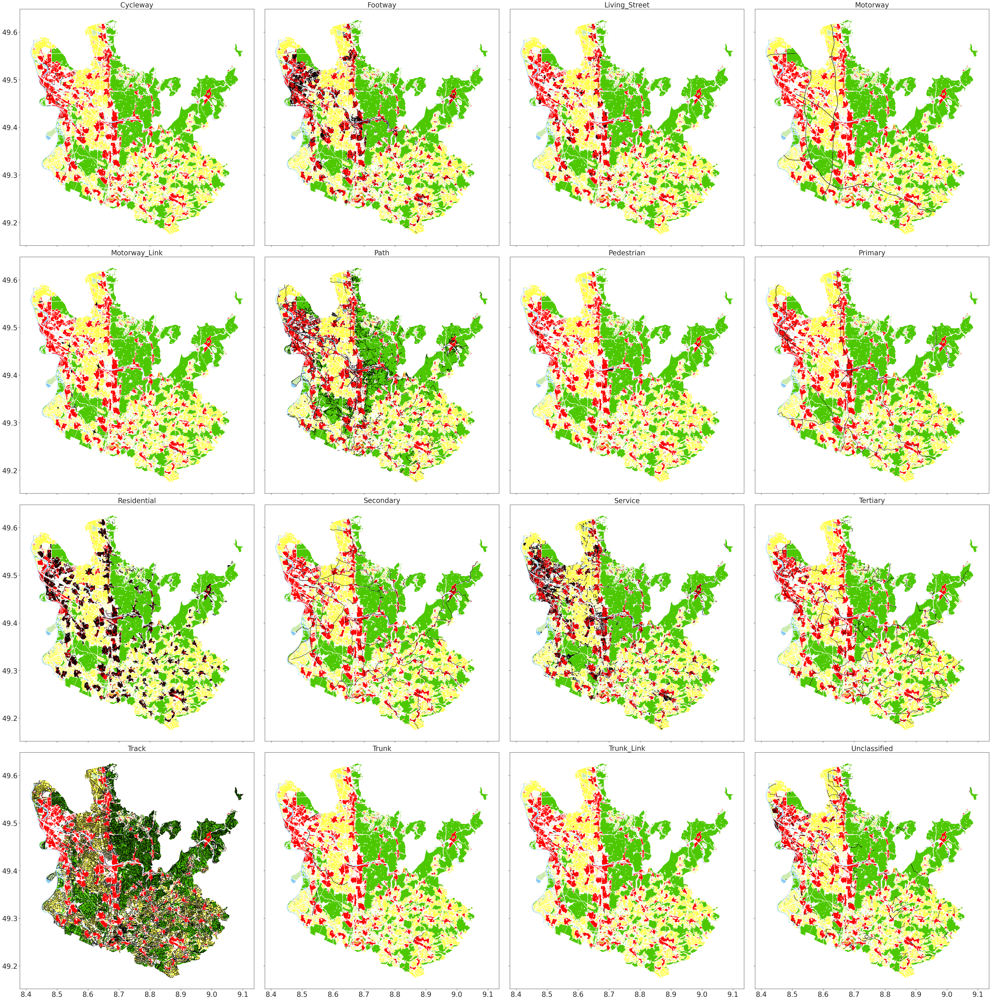

In [39]:
# Calculate the number of rows needed for the grid of subplots
n_rows = np.ceil(len(road_types) / 4).astype(int)

fig, axs = plt.subplots(n_rows, 4, figsize=(50, 50), sharex=True, sharey=True)

# Flatten the axs array for easy iteration
axs = axs.flatten()

for i, road_type in enumerate(road_types):
    ax = axs[i]
    lulc_union.plot(color=lulc_union['color'], ax=ax)
    road_network[road_network['highway'] == road_type].plot(color='black', ax=ax)
    ax.set_title(road_type.title(), fontsize=25)
    ax.tick_params(axis='both', which='major', labelsize=25)

# Remove unused subplots
for j in range(i+1, len(axs)):
    fig.delaxes(axs[j])

# plt.savefig(out_dir / 'road_types_on_lulc.png', dpi=500, bbox_inches='tight')

plt.tight_layout()
plt.show()

## Statistical relationship: intersect LULC classes by road network and compare lengths and proportions

### Preprocess calculations

Intersect road network with LULC (takes a long time > 1,5 h)

In [ ]:
lulc_roads = gpd.sjoin(road_network, lulc_union, how='inner', predicate='intersects')
lulc_roads_10 = gpd.sjoin(road_network_10, lulc_union, how='inner', predicate='intersects')
lulc_roads_25 = gpd.sjoin(road_network_25, lulc_union, how='inner', predicate='intersects')

Save intersected road files as feather and load again

In [ ]:
lulc_roads.to_feather(out_dir / 'lulc_road_types.feather')
lulc_roads_10.to_feather(out_dir / 'lulc_road_types_10.feather')
lulc_roads_25.to_feather(out_dir / 'lulc_road_types_25.feather')

In [4]:
lulc_roads = gpd.read_feather(out_dir / 'lulc_road_types.feather')
lulc_roads_10 = gpd.read_feather(out_dir / 'lulc_road_types_10.feather')
lulc_roads_25 = gpd.read_feather(out_dir / 'lulc_road_types_25.feather')

Calculate total road length for each LULC class

In [5]:
road_length_by_lulc = lulc_roads.groupby('lulc')['road_length'].sum()
road_length_by_lulc_10 = lulc_roads_10.groupby('lulc')['road_length'].sum()
road_length_by_lulc_25 = lulc_roads_25.groupby('lulc')['road_length'].sum()

In [5]:
round(road_length_by_lulc.unique().sum() / 1000, 2), round(road_length_by_lulc_10.unique().sum() / 1000, 2), round(road_length_by_lulc_25.unique().sum() / 1000, 2)

(18788.17, 29341.54, 33876.99)

Aggregate total road lengths by road type for each LULC class

In [6]:
lulc_pivot = lulc_roads.pivot_table(index='highway', columns='lulc', values='road_length', aggfunc='sum', fill_value=0)
lulc_pivot_10 = lulc_roads_10.pivot_table(index='highway', columns='lulc', values='road_length', aggfunc='sum', fill_value=0)
lulc_pivot_25 = lulc_roads_25.pivot_table(index='highway', columns='lulc', values='road_length', aggfunc='sum', fill_value=0)

### Road Types per LULC Classes

Proportion of each road type per LULC class (Vertical 100 %)

In [7]:
lulc_pivot_percent_lulc = lulc_pivot.divide(lulc_pivot.sum(axis=0), axis=1) * 100
lulc_pivot_percent_lulc_10 = lulc_pivot_10.divide(lulc_pivot_10.sum(axis=0), axis=1) * 100
lulc_pivot_percent_lulc_25 = lulc_pivot_25.divide(lulc_pivot_25.sum(axis=0), axis=1) * 100

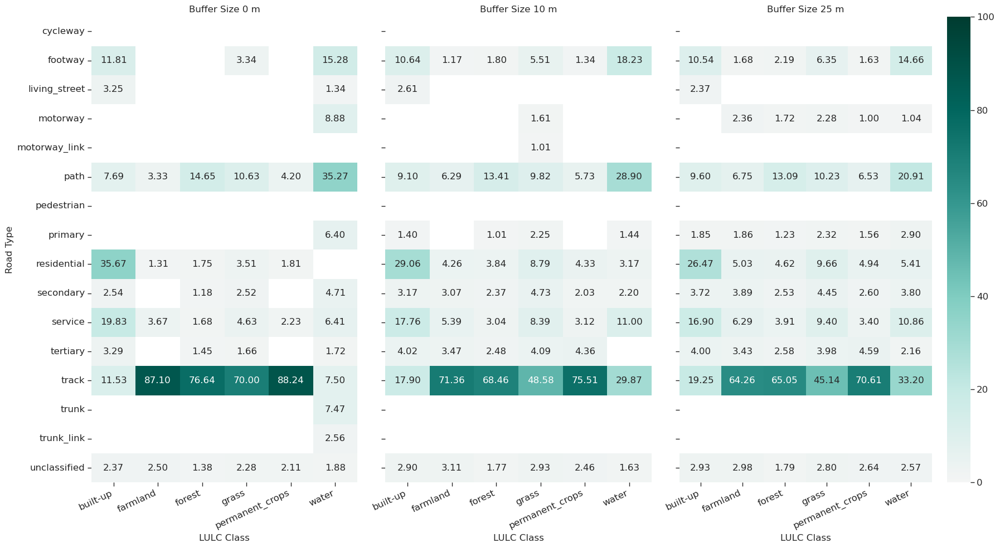

In [81]:
fig, axs = plt.subplots(1, 3, figsize=(18, 10), sharey=True)

vmin=0
vmax=100

mask_lulc = lulc_pivot_percent_lulc < 1
mask_lulc_10 = lulc_pivot_percent_lulc_10 < 1
mask_lulc_25 = lulc_pivot_percent_lulc_25 < 1

# Heatmap for Buffer Size 0 m with custom annotations
sns.heatmap(lulc_pivot_percent_lulc, mask=mask_lulc, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[0])
axs[0].set_title('Buffer Size 0 m')
axs[0].set_ylabel('Road Type')
axs[0].set_xlabel('LULC Class')
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=25, ha='right')

# Heatmap for Buffer Size 10 m with custom annotations
sns.heatmap(lulc_pivot_percent_lulc_10, mask=mask_lulc_10, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[1])
axs[1].set_title('Buffer Size 10 m')
axs[1].set_ylabel('')
axs[1].set_xlabel('LULC Class')
axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=25, ha='right')

# Heatmap for Buffer Size 25 m with custom annotations
sns.heatmap(lulc_pivot_percent_lulc_25, mask=mask_lulc_25, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar_kws={'pad': -0.1, 'anchor': (2.5, 0.5)}, ax=axs[2])
axs[2].set_title('Buffer Size 25 m')
axs[2].set_ylabel('')
axs[2].set_xlabel('LULC Class')
axs[2].set_xticklabels(axs[2].get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_vertical.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

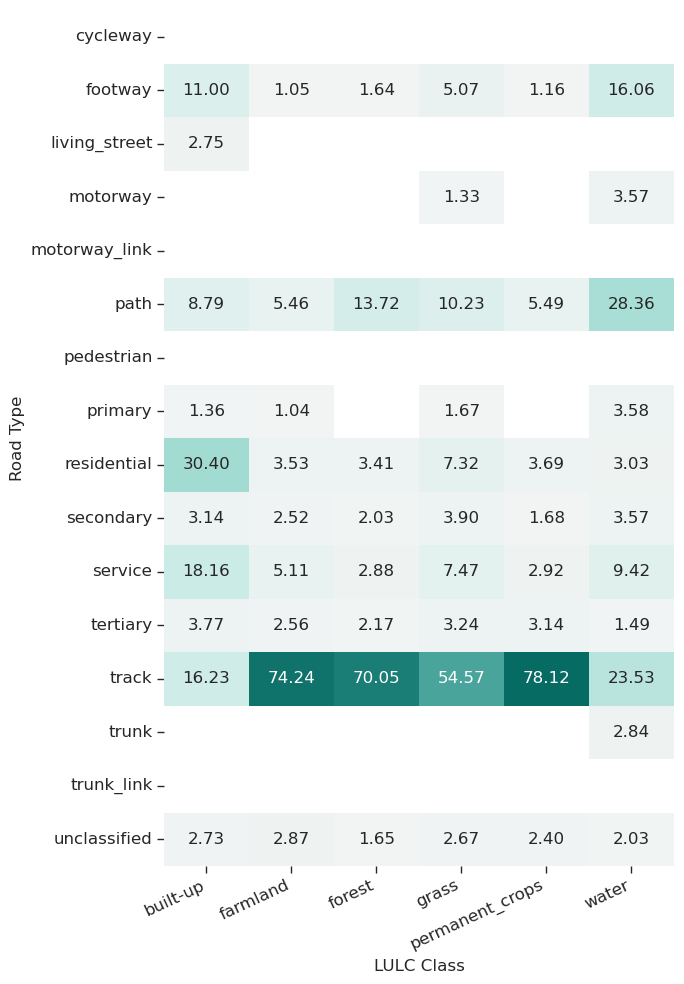

In [79]:
lulc_pivot_percent_lulc_mean = (lulc_pivot_percent_lulc + lulc_pivot_percent_lulc_10 + lulc_pivot_percent_lulc_25) / 3

fig, ax = plt.subplots(figsize=(7, 10))

mask_lulc_mean = lulc_pivot_percent_lulc_mean < 1

sns.heatmap(lulc_pivot_percent_lulc_mean, mask=mask_lulc_mean, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=0, vmax=100, cbar=False, ax=ax)
ax.set_ylabel('Road Type')
ax.set_xlabel('LULC Class')
ax.set_xticklabels(ax.get_xticklabels(), rotation=25, ha='right')

plt.tight_layout()
plt.show()

Calculate differences between buffer sizes

In [46]:
diff_0_to_10_lulc = lulc_pivot_percent_lulc_10 - lulc_pivot_percent_lulc
diff_10_to_25_lulc = lulc_pivot_percent_lulc_25- lulc_pivot_percent_lulc_10
diff_0_to_25_lulc = lulc_pivot_percent_lulc_25 - lulc_pivot_percent_lulc

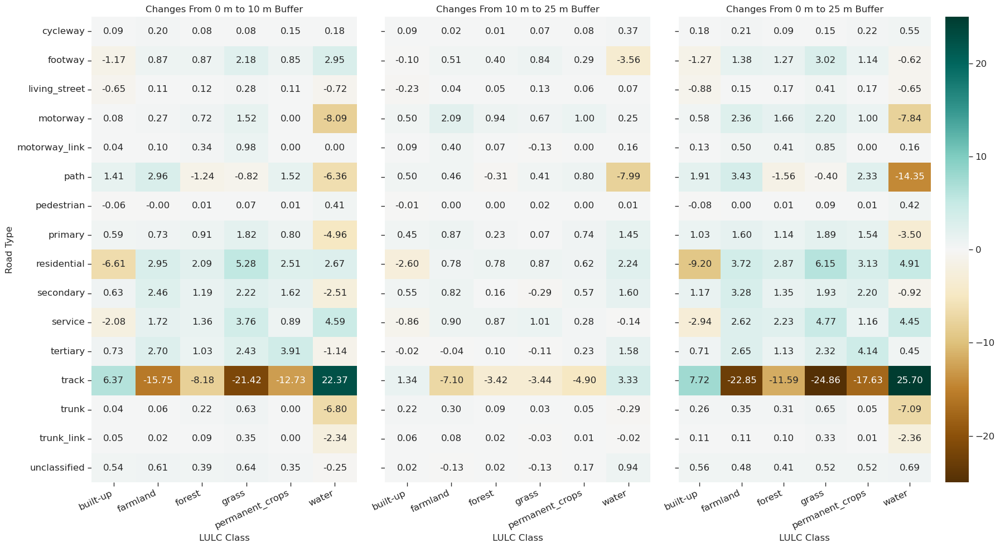

In [82]:
fig, axs = plt.subplots(1, 3, figsize=(18, 10), sharey=True)

vmin=-25
vmax=25

# Difference from 0m to 10m
sns.heatmap(diff_0_to_10_lulc, cmap=cmap_diverging, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[0])
axs[0].set_title('Changes From 0 m to 10 m Buffer')
axs[0].set_ylabel('Road Type')
axs[0].set_xlabel('LULC Class')
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=25, ha='right')

# Difference from 10m to 25m
sns.heatmap(diff_10_to_25_lulc, cmap=cmap_diverging, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[1])
axs[1].set_title('Changes From 10 m to 25 m Buffer')
axs[1].set_ylabel('')
axs[1].set_xlabel('LULC Class')
axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=25, ha='right')

# Difference from 0m to 25m
sns.heatmap(diff_0_to_25_lulc, cmap=cmap_diverging, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar_kws={'pad': -0.1, 'anchor': (2.5, 0.5)}, ax=axs[2])
axs[2].set_title('Changes From 0 m to 25 m Buffer')
axs[2].set_ylabel('')
axs[2].set_xlabel('LULC Class')
axs[2].set_xticklabels(axs[2].get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_vertical_changes.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

### LULC Classes per Road Types

Proportion of a road type belonging to each LULC class (Horizontal 100 %)

In [48]:
lulc_pivot_percent_roads = lulc_pivot.divide(lulc_pivot.sum(axis=1), axis=0) * 100
lulc_pivot_percent_roads_10 = lulc_pivot_10.divide(lulc_pivot_10.sum(axis=1), axis=0) * 100
lulc_pivot_percent_roads_25 = lulc_pivot_25.divide(lulc_pivot_25.sum(axis=1), axis=0) * 100

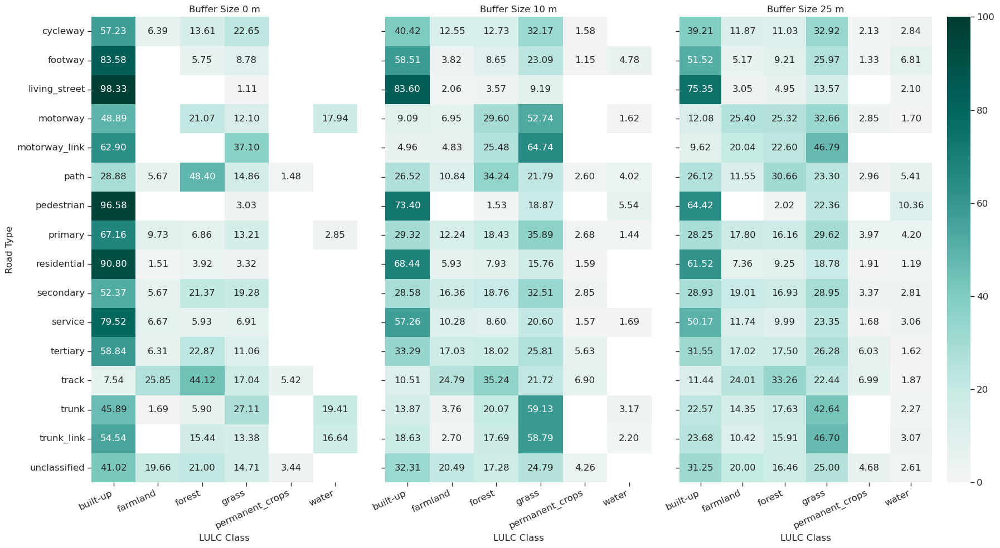

In [83]:
fig, axs = plt.subplots(1, 3, figsize=(18, 10), sharey=True)

vmin=0
vmax=100

mask_roads = lulc_pivot_percent_roads < 1
mask_roads_10 = lulc_pivot_percent_roads_10 < 1
mask_roads_25 = lulc_pivot_percent_roads_25 < 1

sns.heatmap(lulc_pivot_percent_roads, mask=mask_roads, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[0])
axs[0].set_title('Buffer Size 0 m')
axs[0].set_ylabel('Road Type')
axs[0].set_xlabel('LULC Class')
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=25, ha='right')

sns.heatmap(lulc_pivot_percent_roads_10, mask=mask_roads_10, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[1])
axs[1].set_title('Buffer Size 10 m')
axs[1].set_ylabel('')
axs[1].set_xlabel('LULC Class')
axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=25, ha='right')

sns.heatmap(lulc_pivot_percent_roads_25, mask=mask_roads_25, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar_kws={'pad': -0.1, 'anchor': (2.5, 0.5)}, ax=axs[2])
axs[2].set_title('Buffer Size 25 m')
axs[2].set_ylabel('')
axs[2].set_xlabel('LULC Class')
axs[2].set_xticklabels(axs[2].get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_horizontal.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

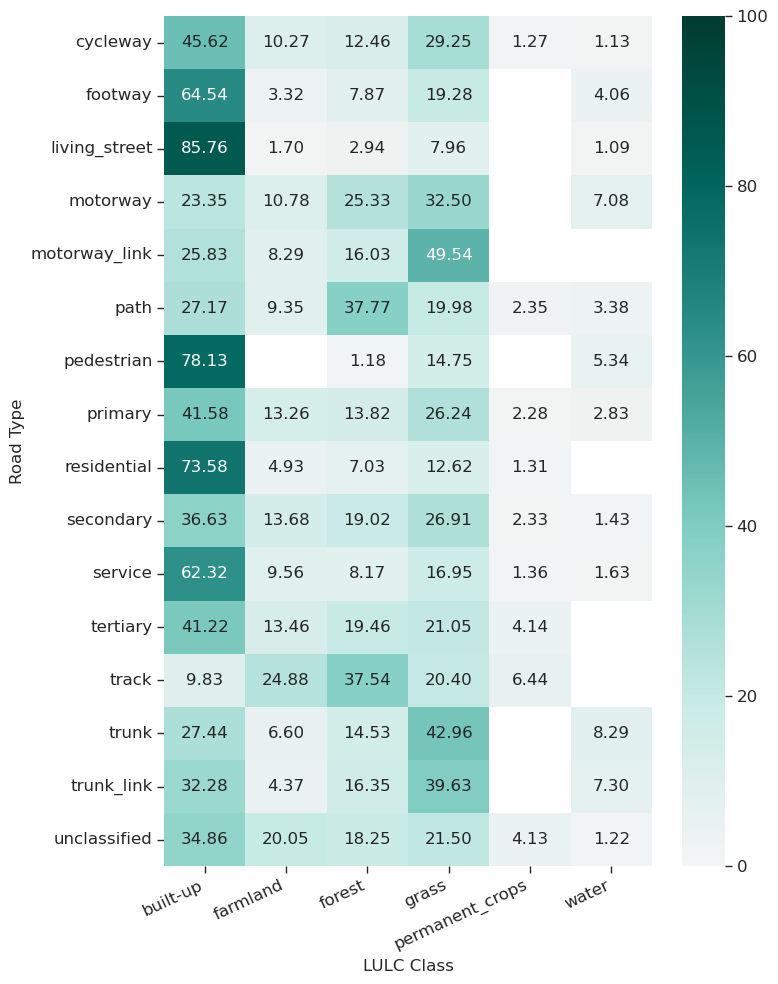

In [50]:
lulc_pivot_percent_roads_mean = (lulc_pivot_percent_roads + lulc_pivot_percent_roads_10 + lulc_pivot_percent_roads_25) / 3

fig, ax = plt.subplots(figsize=(8, 10))

mask_roads_mean = lulc_pivot_percent_roads_mean < 1

sns.heatmap(lulc_pivot_percent_roads_mean, mask=mask_roads_mean, cmap=cmap_sequential, annot=True, fmt='.2f', vmin=0, vmax=100, cbar=True, ax=ax)
ax.set_ylabel('Road Type')
ax.set_xlabel('LULC Class')
ax.set_xticklabels(ax.get_xticklabels(), rotation=25, ha='right')

plt.tight_layout()
plt.show()

Calculate differences between buffer sizes

In [51]:
diff_0_to_10_roads = lulc_pivot_percent_roads_10 - lulc_pivot_percent_roads
diff_10_to_25_roads = lulc_pivot_percent_roads_25- lulc_pivot_percent_roads_10
diff_0_to_25_roads = lulc_pivot_percent_roads_25 - lulc_pivot_percent_roads

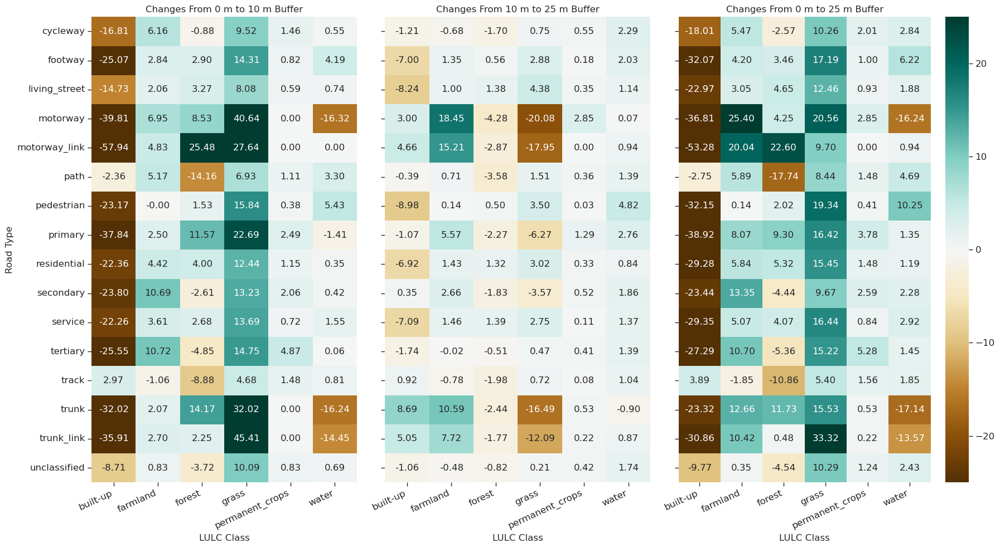

In [84]:
fig, axs = plt.subplots(1, 3, figsize=(18, 10), sharey=True)

vmin=-25
vmax=25

sns.heatmap(diff_0_to_10_roads, cmap=cmap_diverging, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[0])
axs[0].set_title('Changes From 0 m to 10 m Buffer')
axs[0].set_ylabel('Road Type')
axs[0].set_xlabel('LULC Class')
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=25, ha='right')

sns.heatmap(diff_10_to_25_roads, cmap=cmap_diverging, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar=False, ax=axs[1])
axs[1].set_title('Changes From 10 m to 25 m Buffer')
axs[1].set_ylabel('')
axs[1].set_xlabel('LULC Class')
axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=25, ha='right')

sns.heatmap(diff_0_to_25_roads, cmap=cmap_diverging, annot=True, fmt='.2f', vmin=vmin, vmax=vmax, cbar_kws={'pad': -0.1, 'anchor': (2.5, 0.5)}, ax=axs[2])
axs[2].set_title('Changes From 0 m to 25 m Buffer')
axs[2].set_ylabel('')
axs[2].set_xlabel('LULC Class')
axs[2].set_xticklabels(axs[2].get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_horizontal_changes.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

Pearson Correlation Analysis between LULC classes (because based on road types)

In [53]:
# Calculate p-values of according correlation coefficient
def compute_p_values(df):
    # Initialize an empty DataFrame with the same columns and indices as the input
    p_values = pd.DataFrame(index=df.columns, columns=df.columns)
    # Iterate over all pairs of columns
    for col1 in df.columns:
        for col2 in df.columns:
            # Compute the Pearson correlation and p-value
            _, p_value = pearsonr(df[col1], df[col2])
            # Assign the p-value to the corresponding cell in the output DataFrame
            p_values.loc[col1, col2] = p_value
    return p_values

In [54]:
# Categorize p-values and add as annotations to heatmap
def format_corr_with_pval(correlation_matrix, p_values_matrix):
    # Initialize an empty matrix with the same shape as the correlation matrix
    formatted_matrix = correlation_matrix.astype(str)
    # Iterate over the matrix elements
    for row in range(correlation_matrix.shape[0]):
        for col in range(correlation_matrix.shape[1]):
            value = correlation_matrix.iloc[row, col]
            p_value = p_values_matrix.iloc[row, col]
            # Check if comparing the same class (self-class correlation)
            if row == col:
                asterisks = ''  # No asterisks for self-class correlation
            else:
                # Determine the number of asterisks based on the p-value
                if p_value < 0.001:
                    asterisks = '***'
                elif p_value < 0.01:
                    asterisks = '**'
                elif p_value < 0.05:
                    asterisks = '*'
                else:
                    asterisks = ''
            # Format the string with the value and asterisks
            formatted_matrix.iloc[row, col] = f'{value:.2f}{asterisks}'
    return formatted_matrix

In [55]:
correlation_matrix_roads = lulc_pivot_percent_roads.corr(method='pearson')
correlation_matrix_roads_10 = lulc_pivot_percent_roads_10.corr(method='pearson')
correlation_matrix_roads_25 = lulc_pivot_percent_roads_25.corr(method='pearson')

correlation_matrix_roads_mean = lulc_pivot_percent_roads_mean.corr(method='pearson')

In [56]:
p_values_roads = compute_p_values(lulc_pivot_percent_roads)
p_values_roads_10 = compute_p_values(lulc_pivot_percent_roads_10)
p_values_roads_25 = compute_p_values(lulc_pivot_percent_roads_25)

p_values_roads_mean = compute_p_values(lulc_pivot_percent_roads_mean)

In [57]:
p_values_roads = p_values_roads.apply(pd.to_numeric)
p_values_roads_10 = p_values_roads_10.apply(pd.to_numeric)
p_values_roads_25 = p_values_roads_25.apply(pd.to_numeric)

p_values_roads_mean = p_values_roads_mean.apply(pd.to_numeric)

formatted_matrix_roads = format_corr_with_pval(correlation_matrix_roads, p_values_roads)
formatted_matrix_roads_10 = format_corr_with_pval(correlation_matrix_roads_10, p_values_roads_10)
formatted_matrix_roads_25 = format_corr_with_pval(correlation_matrix_roads_25, p_values_roads_25)

formatted_matrix_roads_mean = format_corr_with_pval(correlation_matrix_roads_mean, p_values_roads_mean)

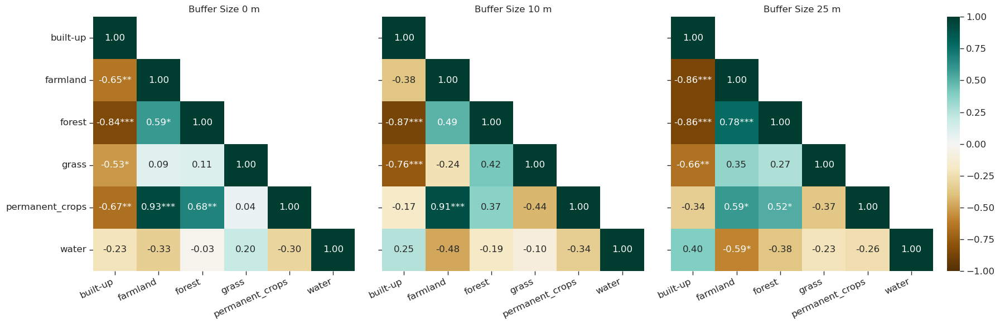

In [65]:
# Create a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix_roads, dtype=bool), k=1)

fig, axs = plt.subplots(1, 3, figsize=(18, 6), sharey=True)

vmin=-1
vmax=1

sns.heatmap(correlation_matrix_roads, cmap=cmap_diverging, annot=formatted_matrix_roads, fmt='', vmin=vmin, vmax=vmax, mask=mask, cbar=False, ax=axs[0])
axs[0].set_title('Buffer Size 0 m')
axs[0].set_ylabel('')
axs[0].set_xlabel('')
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=25, ha='right')

sns.heatmap(correlation_matrix_roads_10, cmap=cmap_diverging, annot=formatted_matrix_roads_10, fmt='', vmin=vmin, vmax=vmax, mask=mask, cbar=False, ax=axs[1])
axs[1].set_title('Buffer Size 10 m')
axs[1].set_ylabel('')
axs[1].set_xlabel('')
axs[1].set_xticklabels(axs[1].get_xticklabels(), rotation=25, ha='right')

sns.heatmap(correlation_matrix_roads_25, cmap=cmap_diverging, annot=formatted_matrix_roads_25, fmt='', vmin=vmin, vmax=vmax, mask=mask, cbar_kws={'pad': -0.15, 'anchor': (2, 0.5)}, ax=axs[2])
axs[2].set_title('Buffer Size 25 m')
axs[2].set_ylabel('')
axs[2].set_xlabel('')
axs[2].set_xticklabels(axs[2].get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_correlation.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

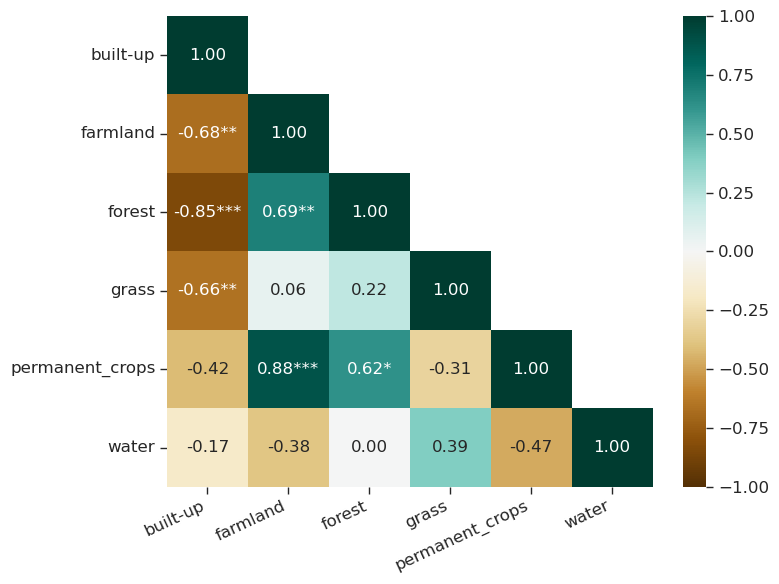

In [59]:
# Create a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix_roads, dtype=bool), k=1)

fig, ax = plt.subplots(figsize=(8, 6))

vmin=-1
vmax=1

sns.heatmap(correlation_matrix_roads_mean, cmap=cmap_diverging, annot=formatted_matrix_roads_mean, fmt='', vmin=vmin, vmax=vmax, mask=mask, ax=ax)
ax.set_ylabel('')
ax.set_xlabel('')
ax.set_xticklabels(ax.get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_correlation.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

Hierachical Clustering Analysis

In [60]:
road_type_cluster = linkage(lulc_pivot_percent_roads, method='ward', optimal_ordering=True)
road_type_cluster_10 = linkage(lulc_pivot_percent_roads_10, method='ward', optimal_ordering=True)
road_type_cluster_25 = linkage(lulc_pivot_percent_roads_25, method='ward', optimal_ordering=True)

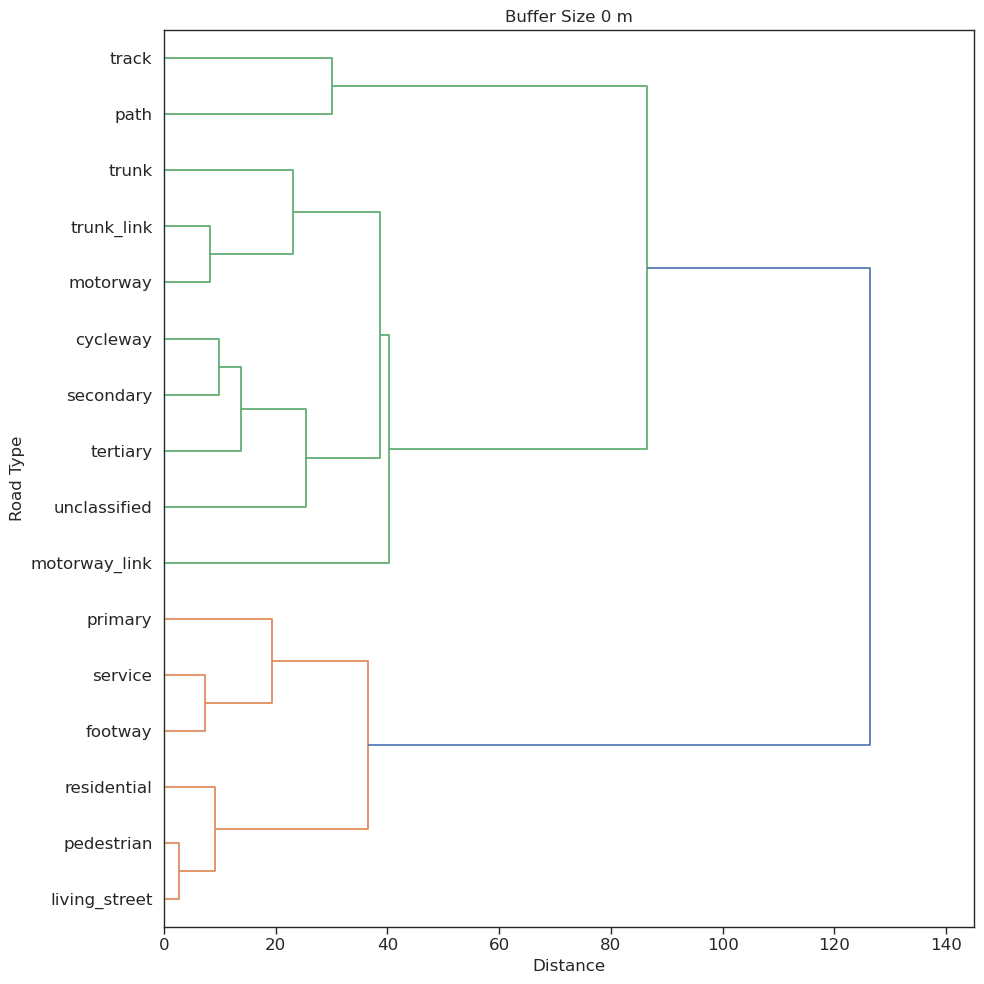

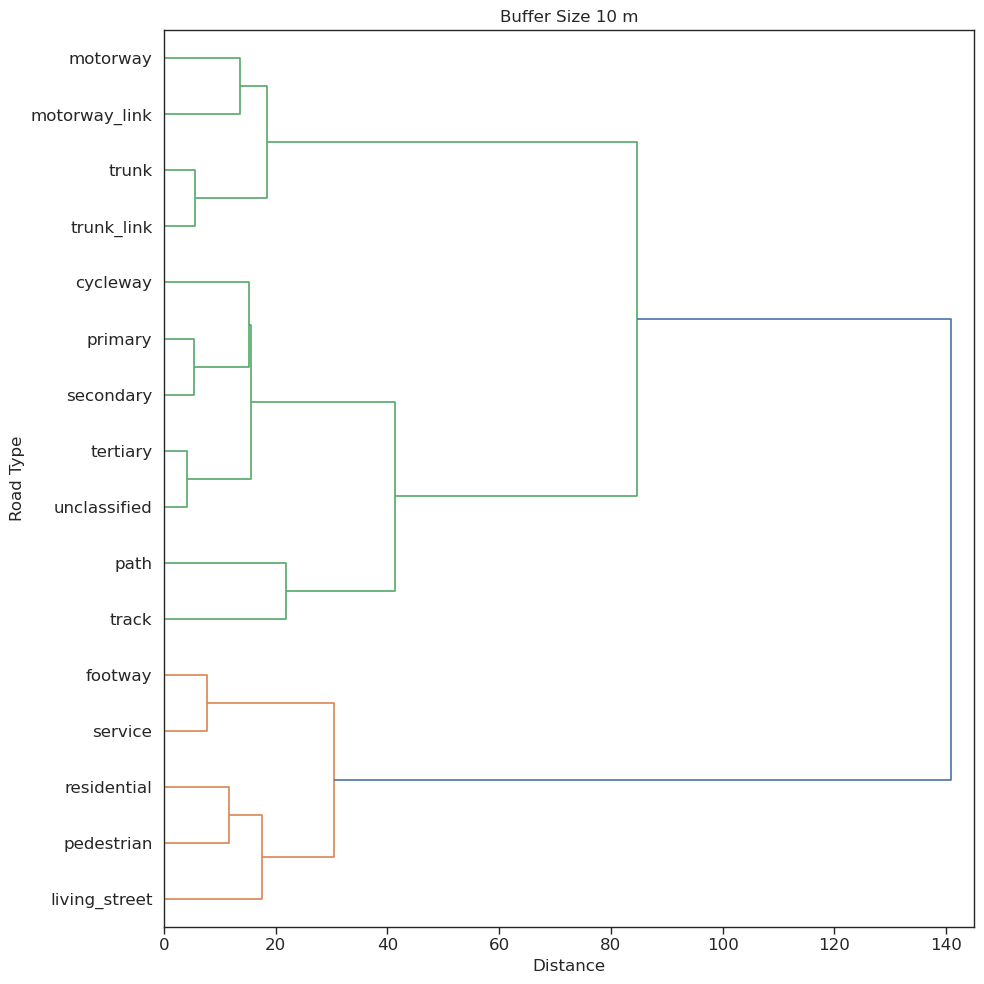

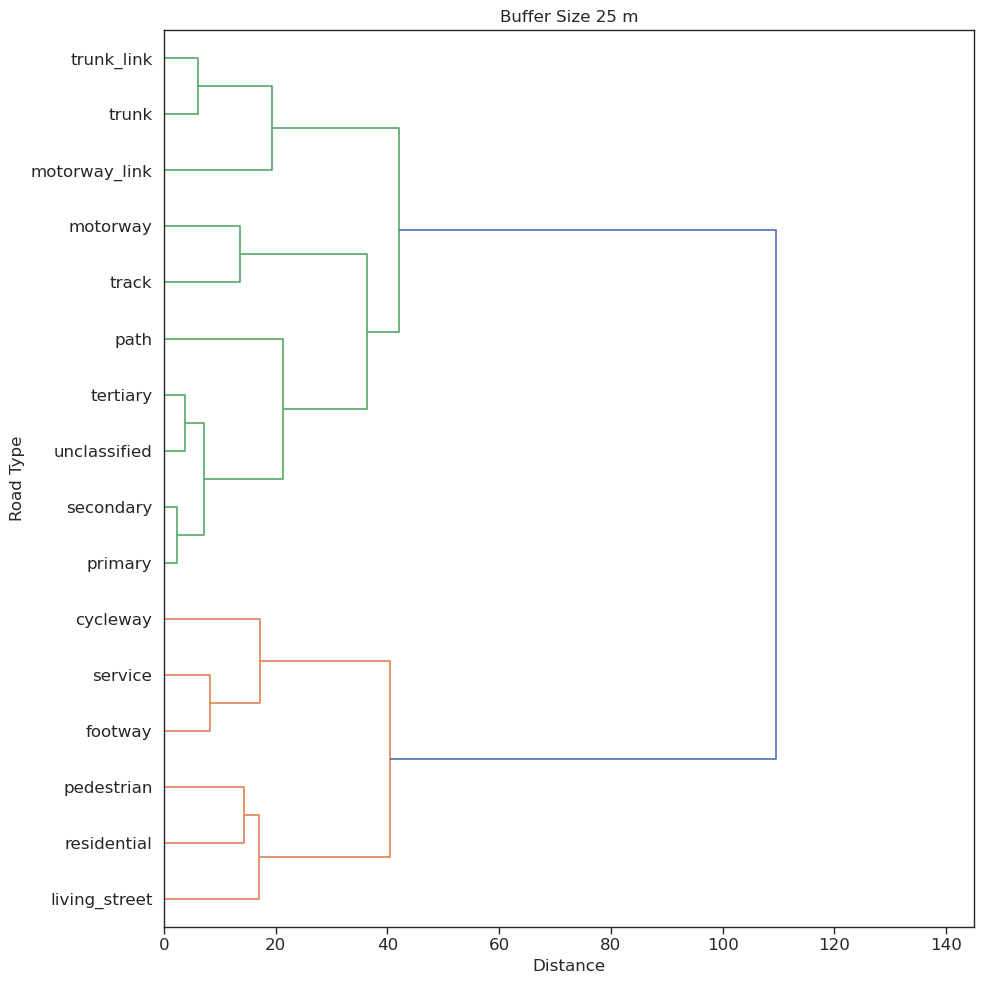

In [61]:
# Dendrogram for lulc_pivot_percent_roads
fig, ax = plt.subplots(figsize=(10, 10))
dendrogram(road_type_cluster, labels=lulc_pivot_percent_roads.index, orientation='right', leaf_font_size=12, ax=ax)
ax.set_title('Buffer Size 0 m')
ax.set_xlabel('Distance')
ax.set_ylabel('Road Type')
ax.set_xlim(0, 145)
plt.tight_layout()
plt.show()

# Dendrogram for lulc_pivot_percent_roads_10
fig, ax = plt.subplots(figsize=(10, 10))
dendrogram(road_type_cluster_10, labels=lulc_pivot_percent_roads_10.index, orientation='right', leaf_font_size=12, ax=ax)
ax.set_title('Buffer Size 10 m')
ax.set_xlabel('Distance')
ax.set_ylabel('Road Type')
ax.set_xlim(0, 145)
plt.tight_layout()
plt.show()

# Dendrogram for lulc_pivot_percent_roads_25
fig, ax = plt.subplots(figsize=(10, 10))
dendrogram(road_type_cluster_25, labels=lulc_pivot_percent_roads_25.index, orientation='right', leaf_font_size=12, ax=ax)
ax.set_title('Buffer Size 25 m')
ax.set_xlabel('Distance')
ax.set_ylabel('Road Type')
ax.set_xlim(0, 145)
plt.tight_layout()
plt.show()

Mean Hierarchical Clustering Analysis

In [62]:
lulc_pivot_percent_roads_mean = (lulc_pivot_percent_roads + lulc_pivot_percent_roads_10 + lulc_pivot_percent_roads_25) / 3
cluster = linkage(lulc_pivot_percent_roads_mean, method='ward', optimal_ordering=True)

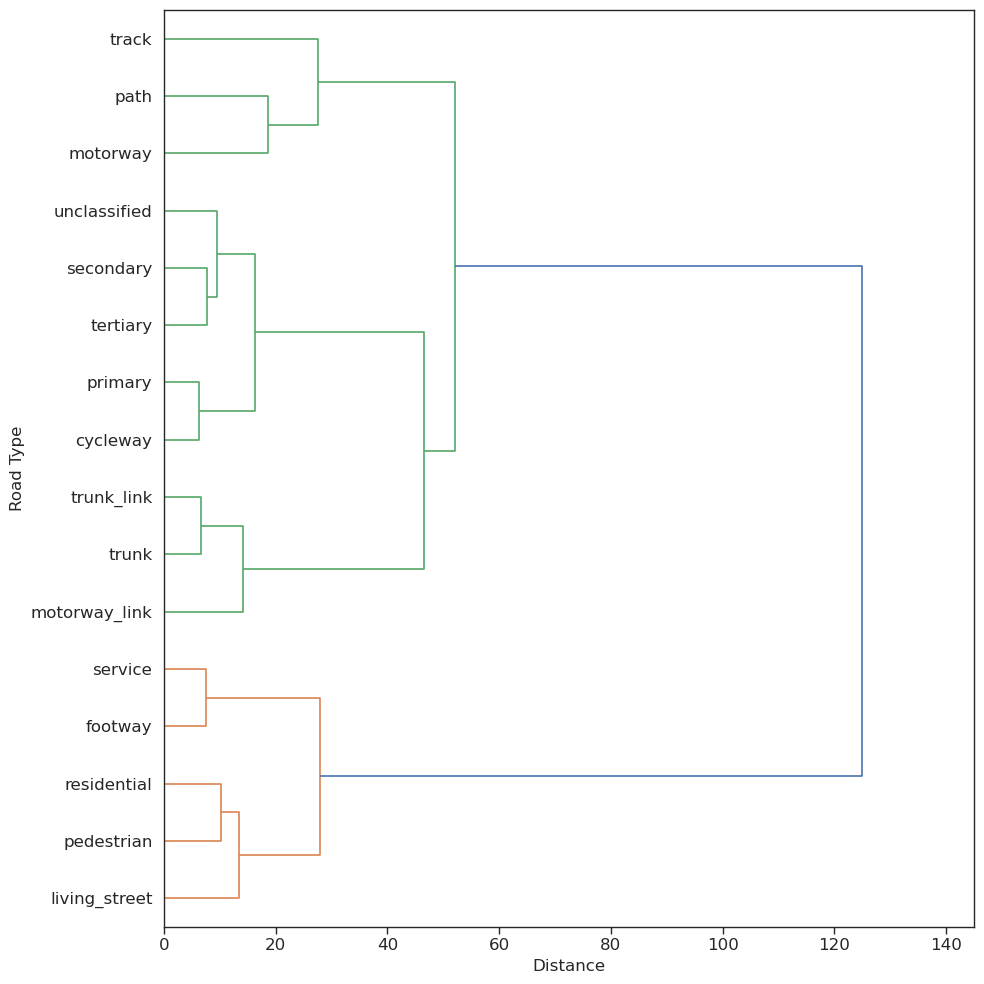

In [63]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

# Dendrogram for lulc_pivot_percent_roads
dendrogram(cluster, labels=lulc_pivot_percent_roads_mean.index, orientation='right', leaf_font_size=12, ax=ax)
ax.set_xlabel('Distance')
ax.set_ylabel('Road Type')
ax.set_xlim(0, 145)

# plt.savefig(out_dir / 'road_types_clustering_mean.png', dpi=150, bbox_inches='tight')

plt.tight_layout()
plt.show()

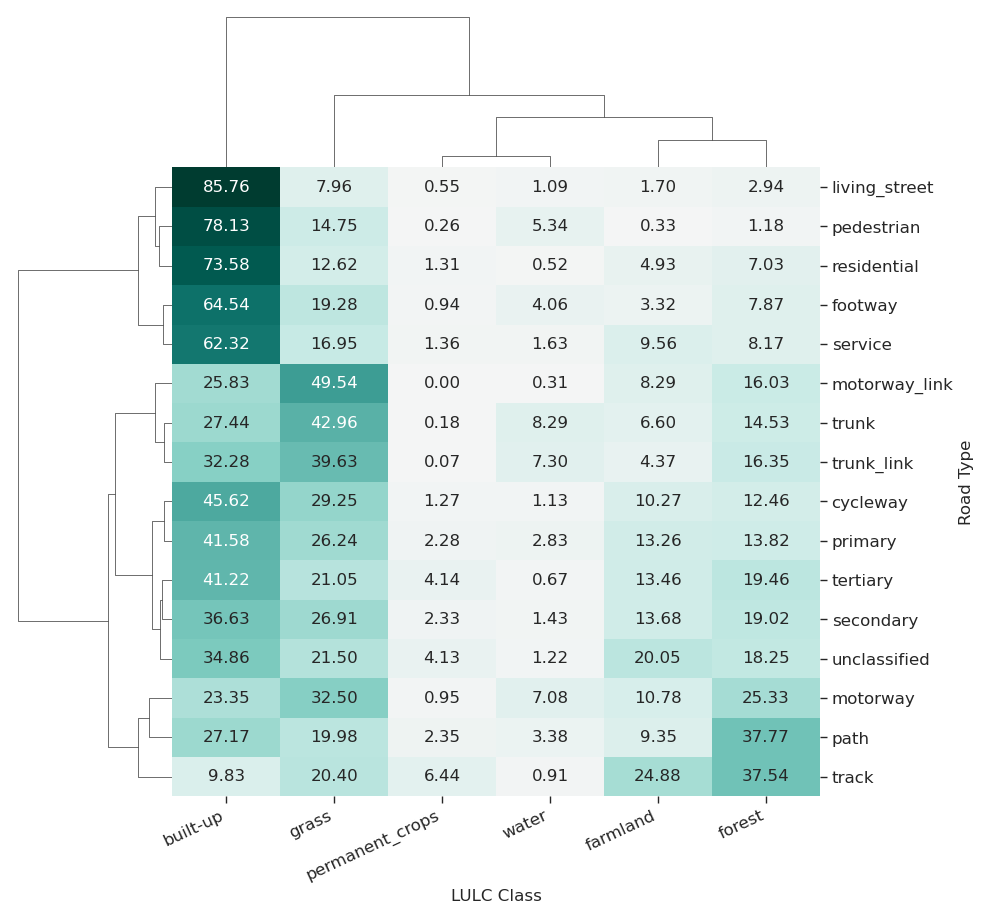

In [85]:
g = sns.clustermap(lulc_pivot_percent_roads_mean, figsize=(10, 10), method='ward', cmap=cmap_sequential,
                   col_cluster=True, row_linkage=cluster, annot=True, fmt='.2f', cbar_pos=None)

g.ax_heatmap.set_xlabel('LULC Class')
g.ax_heatmap.set_ylabel('Road Type')
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=25, ha='right')

# plt.savefig(out_dir / 'road_types_lulc_dendrogram_mean.png', dpi=150, bbox_inches='tight')

plt.show()